In [1]:
import utils.dataset_utils as dataset
import utils.train_utils as train

import numpy as np
import copy
import pickle

from sklearn.base import BaseEstimator, ClassifierMixin
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from datetime import datetime
from dateutil.relativedelta import relativedelta
import matplotlib.pyplot as plt


plt.rcParams['figure.figsize'] = (20.0, 10.0)
plt.rcParams['figure.dpi'] = 500

In [2]:
def unit_vector_norm(X):
    return (X.T / np.sqrt((X**2).sum(axis=1))).T

In [3]:
NORMALIZE = False
file_location = "../data/Raman_Mouse/approximated/"
file_location_org = "../data/Raman_Mouse/corrected_4_wavenumbers/"
filenames = np.load(f"{file_location}FileNames.npy")
with open(f'{file_location}Sample_labels.pickle', 'rb') as f:
    labels = pickle.load(f)

vector_norm = unit_vector_norm if NORMALIZE else lambda x: x
    
data = []
for f in filenames:
    try:
        raw = np.load(f"{file_location_org}{f.split('.')[0]}.npy")
        raman = np.load(f"{file_location}{f.split('.')[0]}_raman.npy")
        photo = np.load(f"{file_location}{f.split('.')[0]}_photoluminescence.npy")
        data.append((vector_norm(raw.reshape(-1,raw.shape[-1])).reshape(raw.shape),
                     vector_norm(raman.reshape(-1,raman.shape[-1])).reshape(raman.shape),
                     vector_norm(photo.reshape(-1,photo.shape[-1])).reshape(photo.shape), 
                     labels[f]))
    except:
        pass

In [4]:
class AE(nn.Module):
    def __init__(self, num_input_channels=1, base_channel_size=3, latent_dim=130, **kwargs):
        super().__init__()
        
        self.encoder = Encoder(num_input_channels, base_channel_size, latent_dim)
        self.decoder = Decoder(num_input_channels, base_channel_size, latent_dim)
  
    def forward(self, x):
        x = x.reshape(-1, 1, x.shape[-1])
        z = self.encoder(x)
        x_hat = self.decoder(z)
        return x_hat.reshape(x.shape[0],-1)
    
class Encoder(nn.Module):
    def __init__(self,
                 num_input_channels : int,
                 base_channel_size : int,
                 latent_dim : int,
                 act_fn : object = nn.GELU):
        """
        Inputs:
            - num_input_channels : Number of input channels of the image. For CIFAR, this parameter is 3
            - base_channel_size : Number of channels we use in the first convolutional layers. Deeper layers might use a duplicate of it.
            - latent_dim : Dimensionality of latent representation z
            - act_fn : Activation function used throughout the encoder network
        """
        super().__init__()
        c_hid = base_channel_size
        self.net = nn.Sequential(
            nn.Conv1d(num_input_channels, c_hid, kernel_size=3, padding=1, stride=2), # 32x32 => 16x16
            act_fn(),
            nn.Conv1d(c_hid, c_hid, kernel_size=3, padding=1),
            act_fn(),
            nn.Conv1d(c_hid, 2*c_hid, kernel_size=3, padding=1, stride=2), # 16x16 => 8x8
            act_fn(),
            nn.Conv1d(2*c_hid, 2*c_hid, kernel_size=3, padding=1),
            act_fn(),
            nn.Conv1d(2*c_hid, 4*c_hid, kernel_size=3, padding=1, stride=5), # 8x8 => 4x4
            act_fn(),
            nn.Flatten(), # Image grid to single feature vector
            nn.Linear(4*65*c_hid, 2*latent_dim)
        )

    def forward(self, x):
        return self.net(x)
    
class Decoder(nn.Module):

    def __init__(self,
                 num_input_channels : int,
                 base_channel_size : int,
                 latent_dim : int,
                 act_fn : object = nn.GELU):
        """
        Inputs:
            - num_input_channels : Number of channels of the image to reconstruct. For CIFAR, this parameter is 3
            - base_channel_size : Number of channels we use in the last convolutional layers. Early layers might use a duplicate of it.
            - latent_dim : Dimensionality of latent representation z
            - act_fn : Activation function used throughout the decoder network
        """
        super().__init__()
        c_hid = base_channel_size
        self.linear_raman = nn.Sequential(
            nn.Linear(latent_dim, 2*65*c_hid),
            act_fn()
        )
        
        self.net_raman = nn.Sequential(
            nn.ConvTranspose1d(2*c_hid, 2*c_hid, kernel_size=3, output_padding=4, padding=1, stride=5), # 4x4 => 8x8
            act_fn(),
            nn.Conv1d(2*c_hid, 2*c_hid, kernel_size=3, padding=1),
            act_fn(),
            nn.ConvTranspose1d(2*c_hid, c_hid, kernel_size=3, output_padding=1, padding=1, stride=2), # 8x8 => 16x16
            act_fn(),
            nn.Conv1d(c_hid, c_hid, kernel_size=3, padding=1),
            act_fn(),
            nn.ConvTranspose1d(c_hid, num_input_channels, kernel_size=3, output_padding=1, padding=1, stride=2), # 16x16 => 32x32
            nn.ReLU() 
        )
        
        self.linear_photo = nn.Sequential(
            nn.Linear(latent_dim, 2*latent_dim),
            act_fn(),
            nn.Linear(2*latent_dim, 2*latent_dim),
            act_fn(),
            nn.Linear(2*latent_dim, 10*latent_dim),
            act_fn(),
        )
        
        self.net_photo == nn.Sequential(
            nn.ConvTranspose1d(2*c_hid, 2*c_hid, kernel_size=3, output_padding=4, padding=1, stride=5), # 4x4 => 8x8
            nn.ReLU() 
        )


    def forward(self, x):
        x = x.reshape(x.shape[0], 2, -1)
        raman = x[:,0,:]
        photo = x[:,1,:]
        raman = self.linear_raman(raman)
        raman = raman.reshape(raman.shape[0], -1, 65)
        raman, photo = self.net_raman(raman), self.linear_photo(photo)
        photo = photo.reshape(photo.shape[0], 1, -1)
        return torch.cat((raman, photo), -1)

In [5]:
class SupervisedClassifier(BaseEstimator):
    def __init__(self, **kwargs):
        self.kwargs = kwargs

        _use_cuda = torch.cuda.is_available() and kwargs['cuda']
        if _use_cuda:
            torch.backends.cudnn.enabled = True
            torch.backends.cudnn.benchmark = True
        self.device = torch.device('cuda' if _use_cuda else 'cpu')        
        
    def fit(self, data):
        self.model = AE(**self.kwargs).to(self.device)

        parameters = filter(lambda x: x.requires_grad, self.model.parameters())
        self.optimizer = optim.Adam(parameters, lr=0.001)        
        train_loader, test_loader = dataset.load_splitdata(data, self.kwargs['batch_size'])
        
        for epoch in range(self.kwargs['epochs']):
            print('-'*50)
            print('Epoch {:3d}/{:3d}'.format(epoch+1, self.kwargs['epochs']))
            start_time = datetime.now()
            train.train(self.model, self.optimizer, train_loader, self.kwargs['loss_func'], self.kwargs['acc_func'], self.kwargs['log_step'], self.device)
            end_time = datetime.now()
            time_diff = relativedelta(end_time, start_time)
            print('Elapsed time: {}h {}m {}s'.format(time_diff.hours, time_diff.minutes, time_diff.seconds))
            loss = train.test(self.model, test_loader, self.kwargs['loss_func'], self.kwargs['acc_func'], self.device)
            print('Validation| bits: {:2.2f}'.format(loss), flush=True)    
                         
        return self
    
    def predict(self, X):
        """
        predict transforms the data into the reference space. Min weight should be 0 or higher then 'min_weight'
        The error is the NMSE, where the MSE is normalised by the signal strength. 
        error.shape = X.shape[0], so for each data point the error is calculated.
        """
        # Check is fit had been called
        check_is_fitted(self)

        # Input validation
        X = check_array(X)
#         self.model(X)
        
#         return RCA_vector

In [6]:
loss = nn.MSELoss(size_average=None, reduce=None, reduction='mean')

def loss_func(y, y_):
    raman, photo, _ = y
    raman = raman.to(y_.device)
    photo = photo.to(y_.device)
    x = torch.cat((raman, photo), -1)
    return loss(x, y_)

def acc_func(y, y_):
    y_clone = torch.clone(y_)
    y_clone = y_clone.detach().numpy()
    plt.plot(y_clone[0][:1300])
    plt.plot(y_clone[0][1300:])
    plt.plot(y[0][0])
    plt.plot(y[1][0])
    plt.show()
    return loss_func(y, y_)

In [7]:
BATCH_SIZE = 64
EPOCHS = 10

kwargs = {'batch_size': BATCH_SIZE,
          'cuda': True,
          'log_step': 200,
          'epochs': EPOCHS,
          'loss_func': loss_func,
          'acc_func' : acc_func,
          'bias': True,
          'base_channel_size': 10, 
          'latent_dim': 130
         }

--------------------------------------------------
Epoch   1/ 10


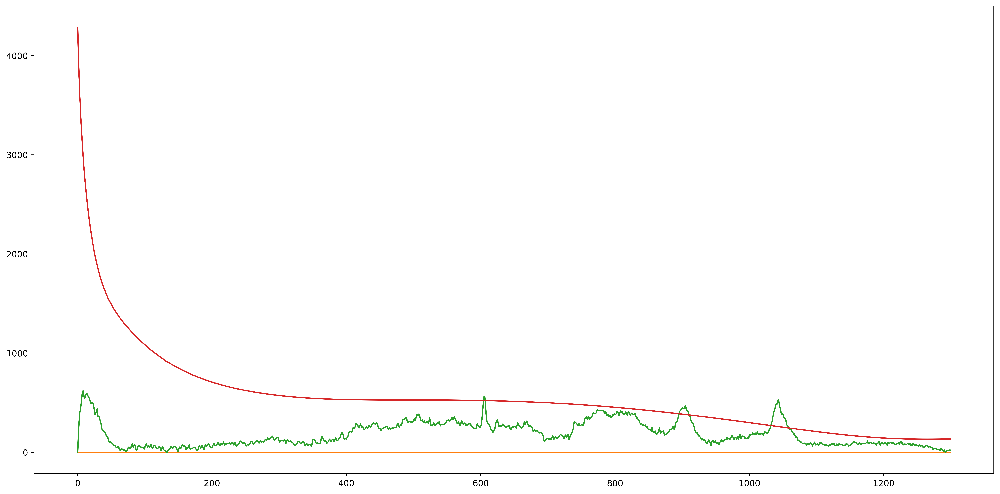

  2022-04-13 09:56:58|     0/ 2637| bits: 750632.19


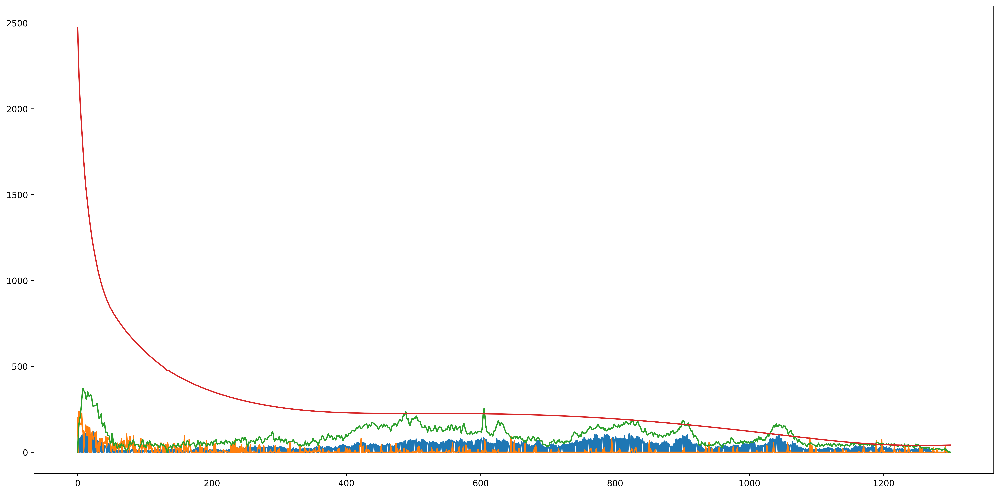

  2022-04-13 09:57:09|   200/ 2637| bits: 569568.38


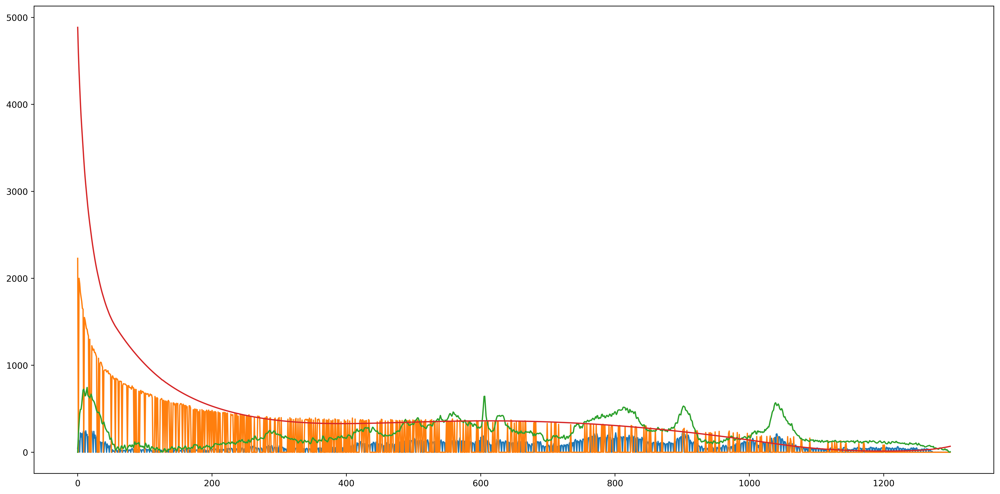

  2022-04-13 09:57:20|   400/ 2637| bits: 283845.50


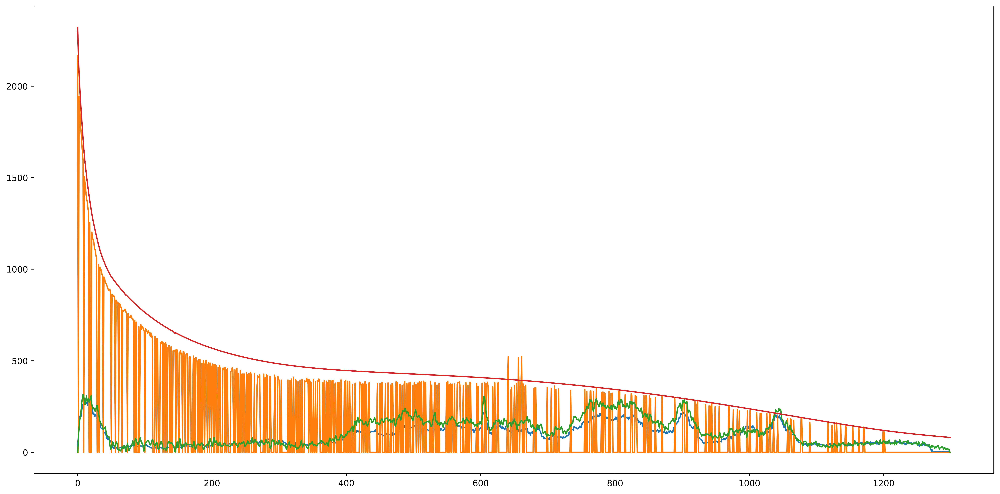

  2022-04-13 09:57:31|   600/ 2637| bits: 733853.81


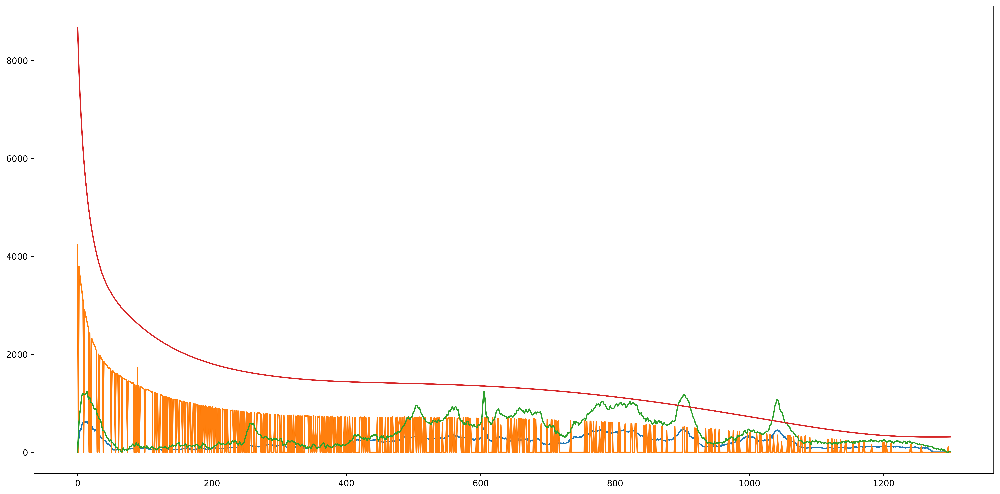

  2022-04-13 09:57:42|   800/ 2637| bits: 234840.20


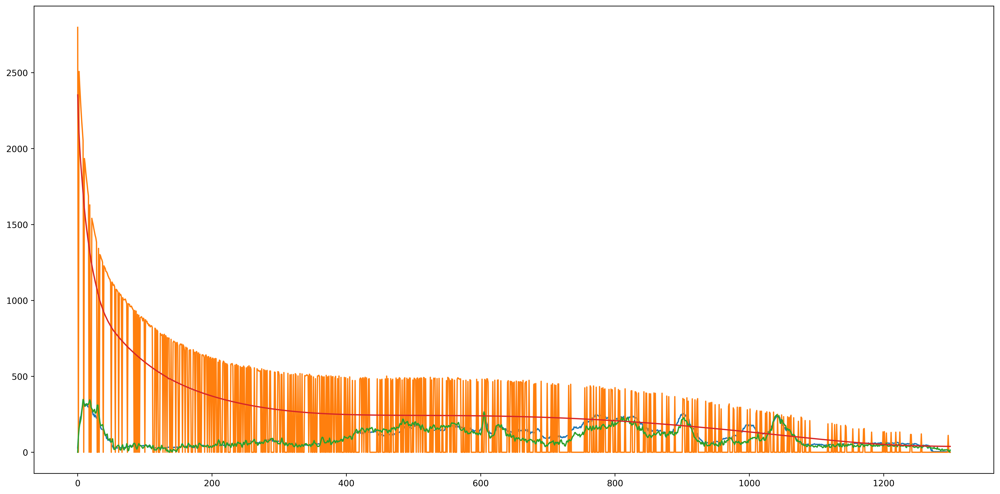

  2022-04-13 09:57:53|  1000/ 2637| bits: 255823.69


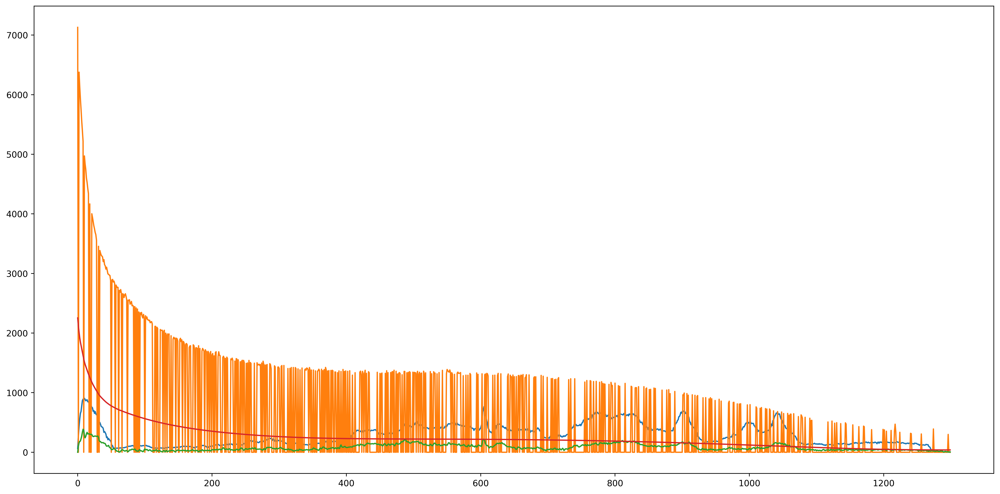

  2022-04-13 09:58:04|  1200/ 2637| bits: 360509.47


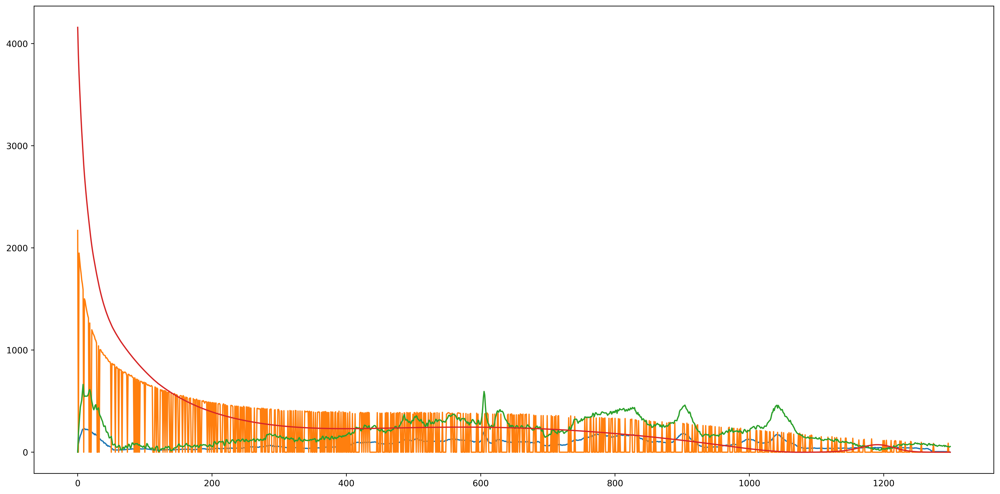

  2022-04-13 09:58:15|  1400/ 2637| bits: 197488.31


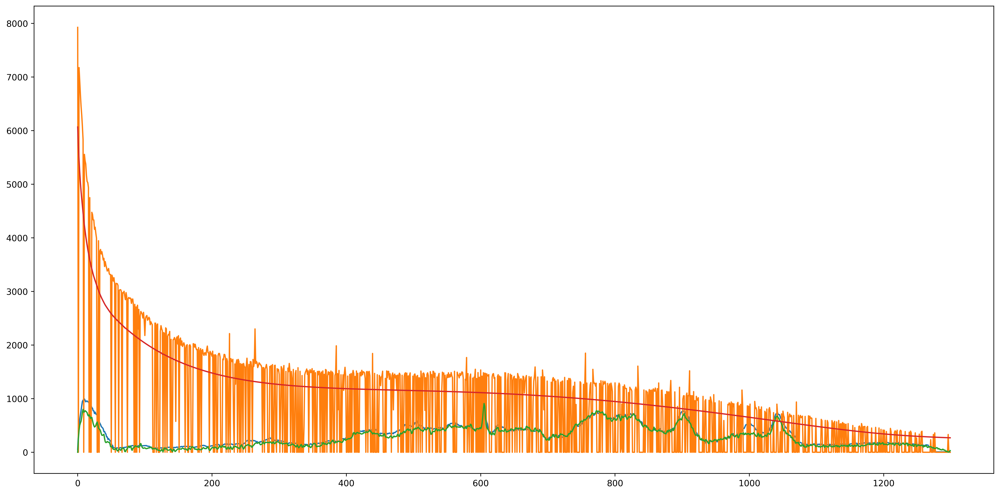

  2022-04-13 09:58:26|  1600/ 2637| bits: 405393.56


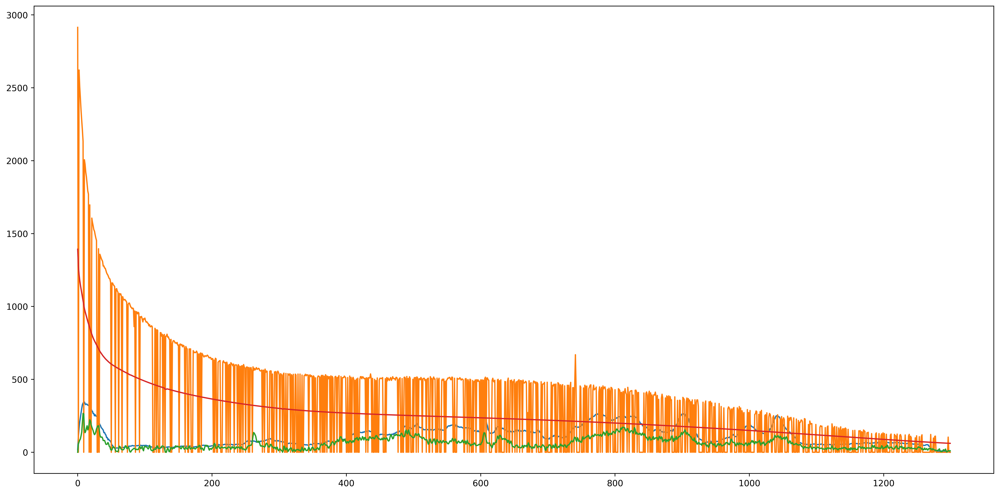

  2022-04-13 09:58:36|  1800/ 2637| bits: 842115.44


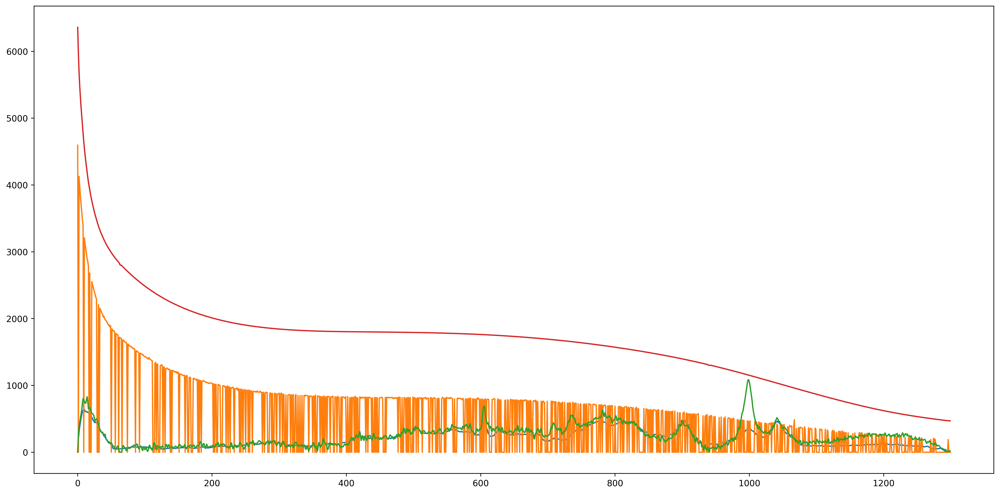

  2022-04-13 09:58:47|  2000/ 2637| bits: 357590.34


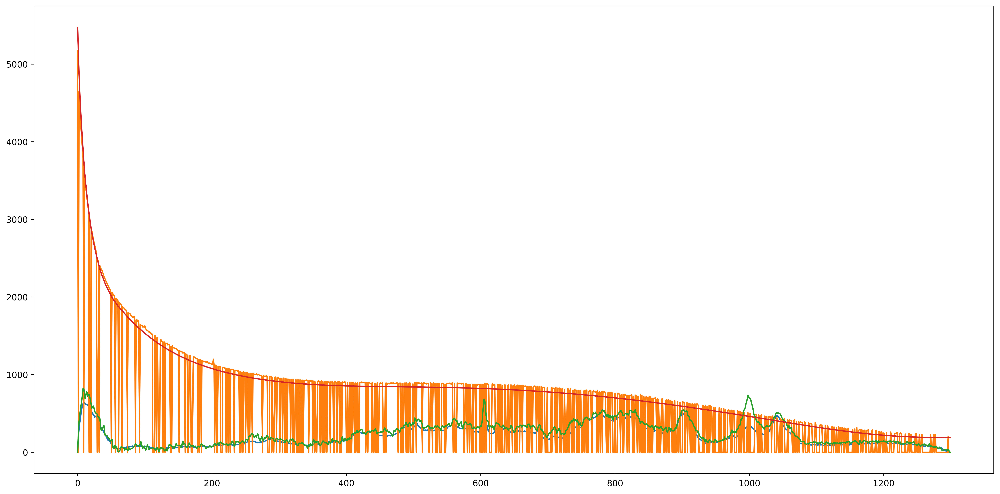

  2022-04-13 09:58:58|  2200/ 2637| bits: 926537.56


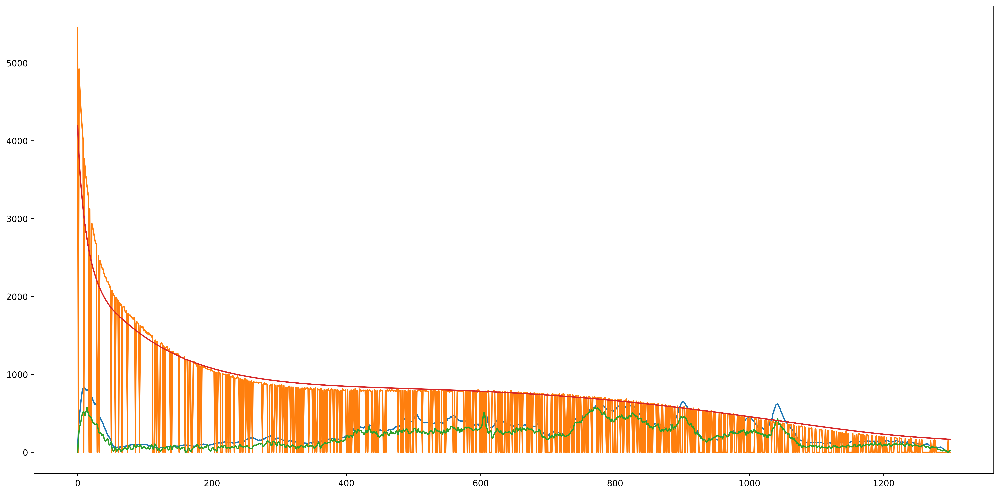

  2022-04-13 09:59:09|  2400/ 2637| bits: 275277.94


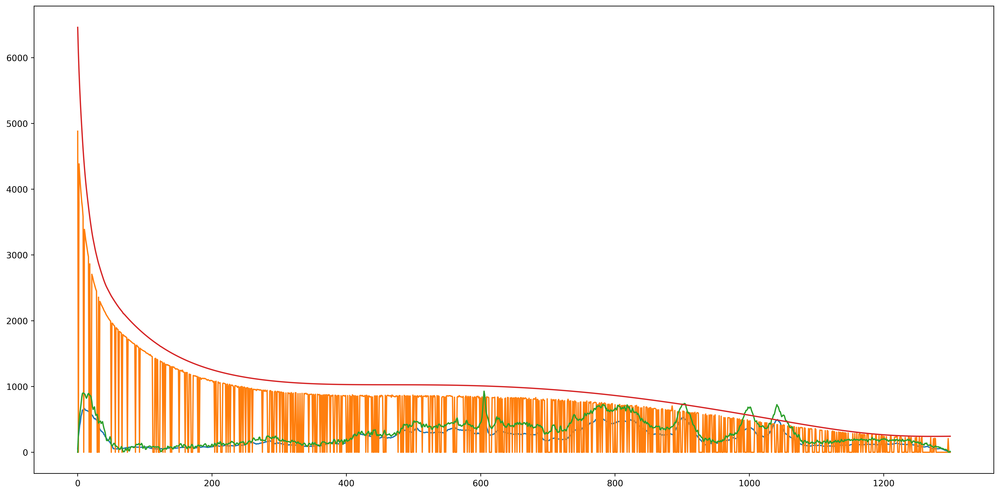

  2022-04-13 09:59:20|  2600/ 2637| bits: 172191.97
Elapsed time: 0h 2m 26s


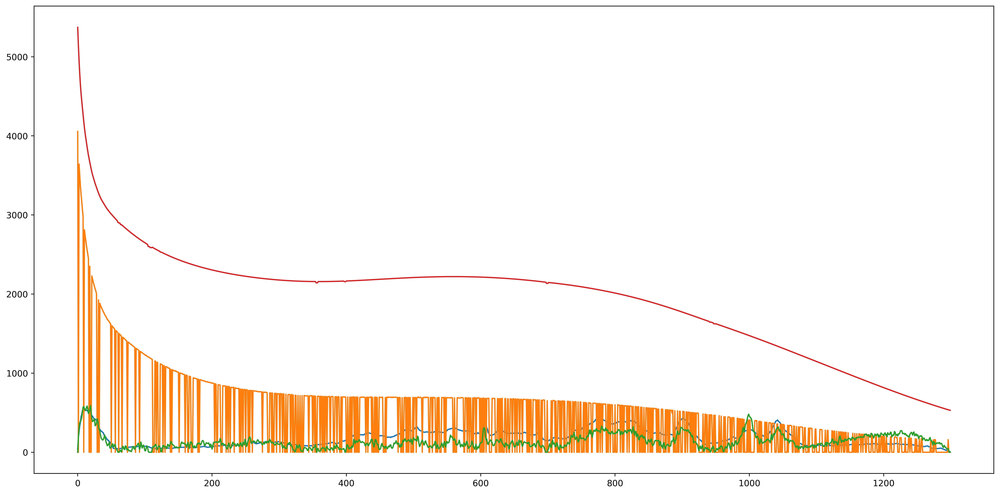

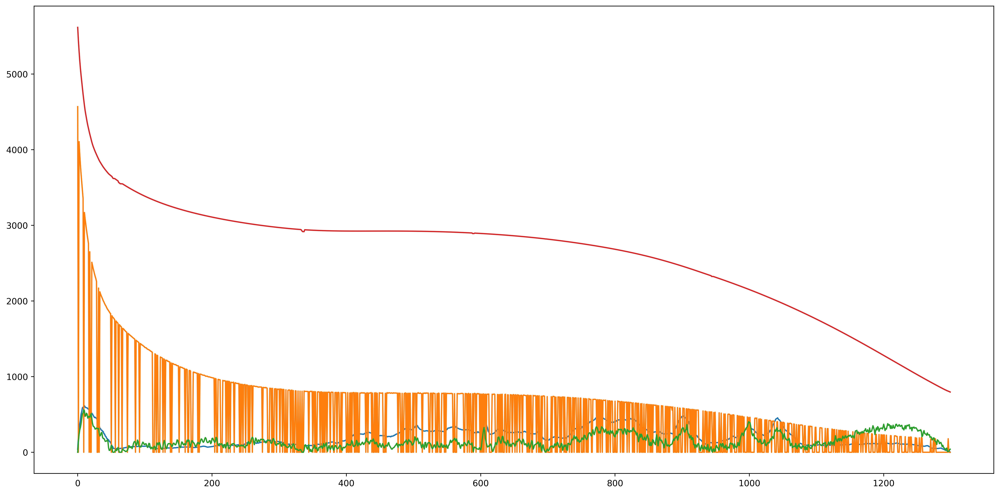

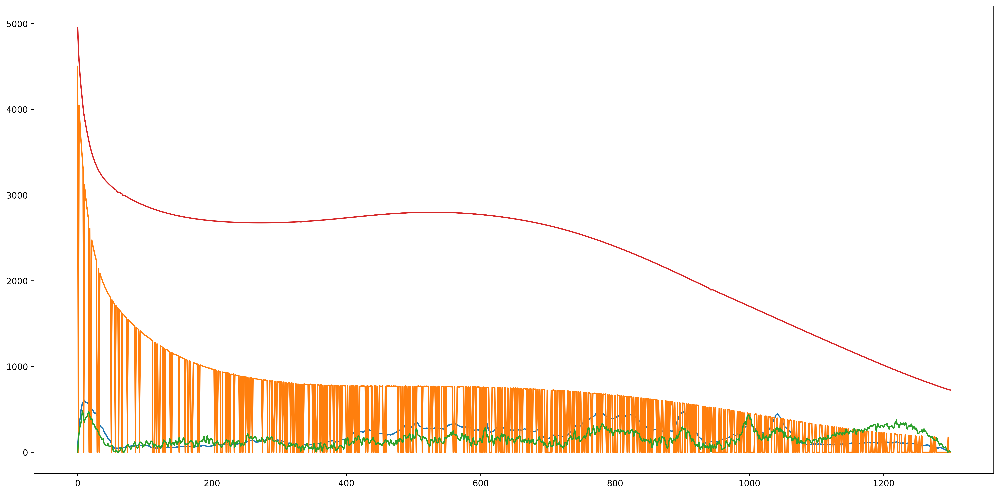

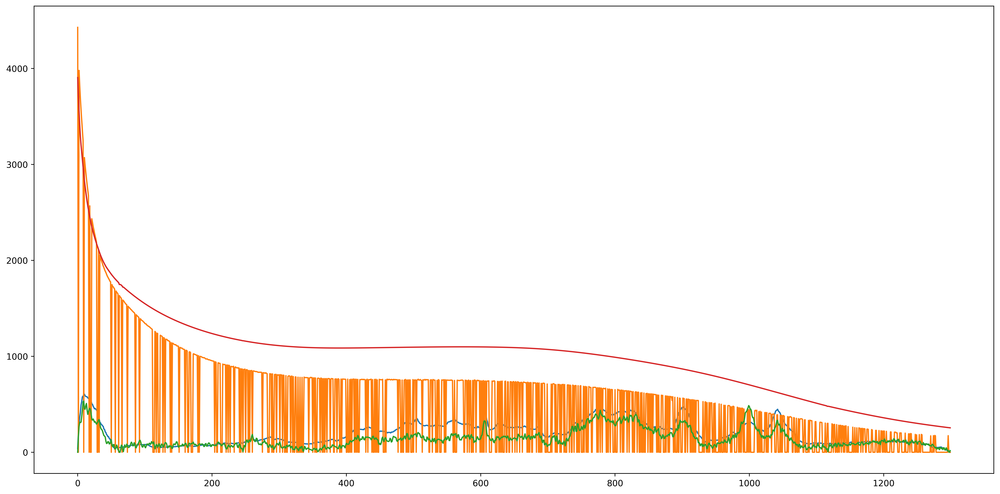

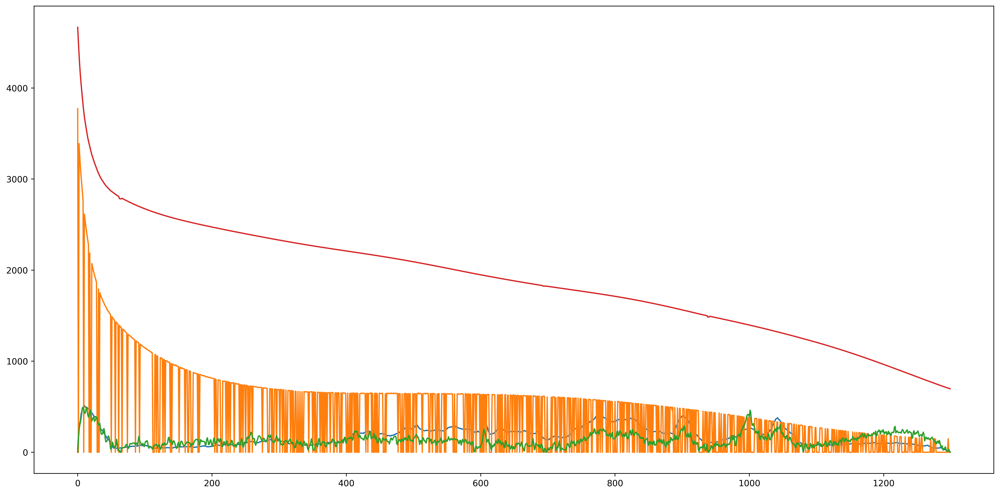

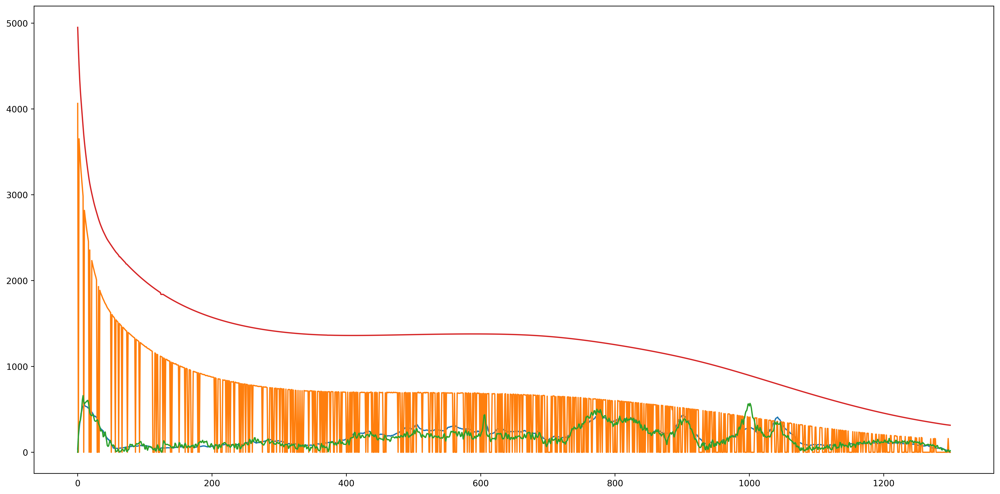

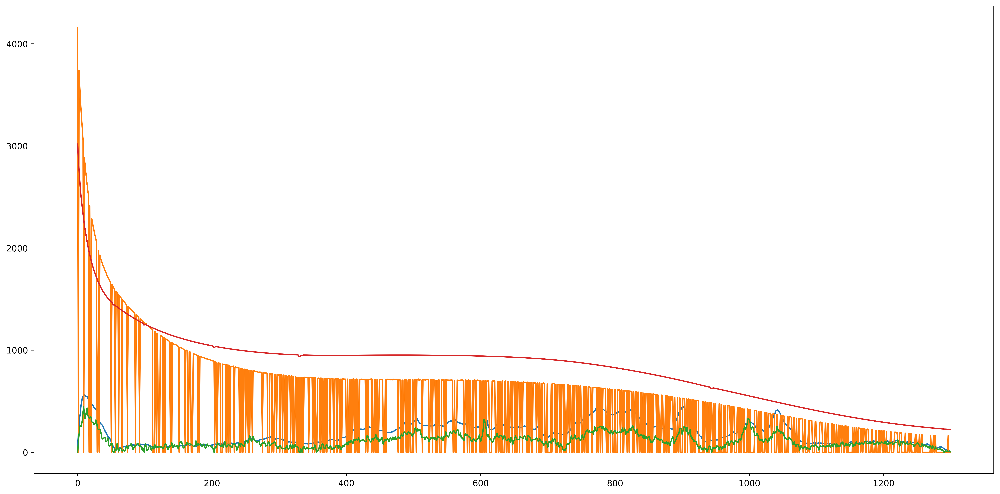

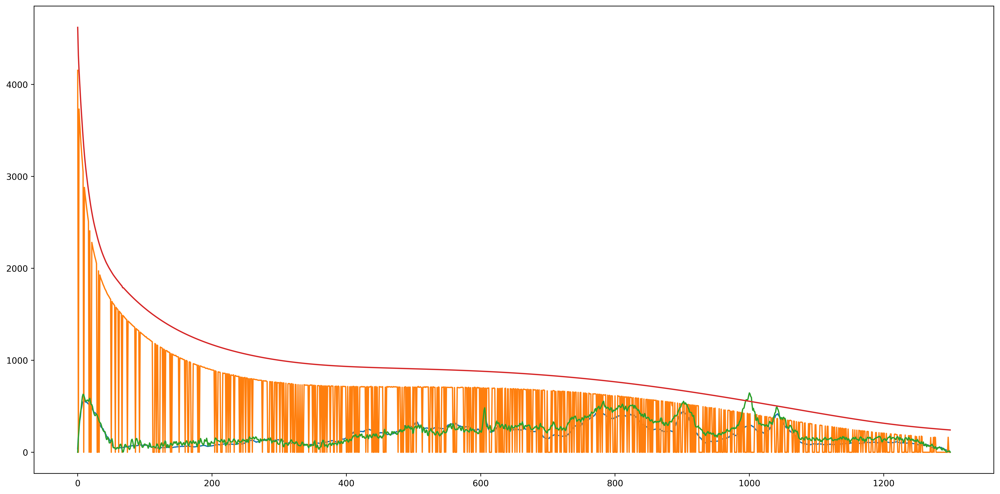

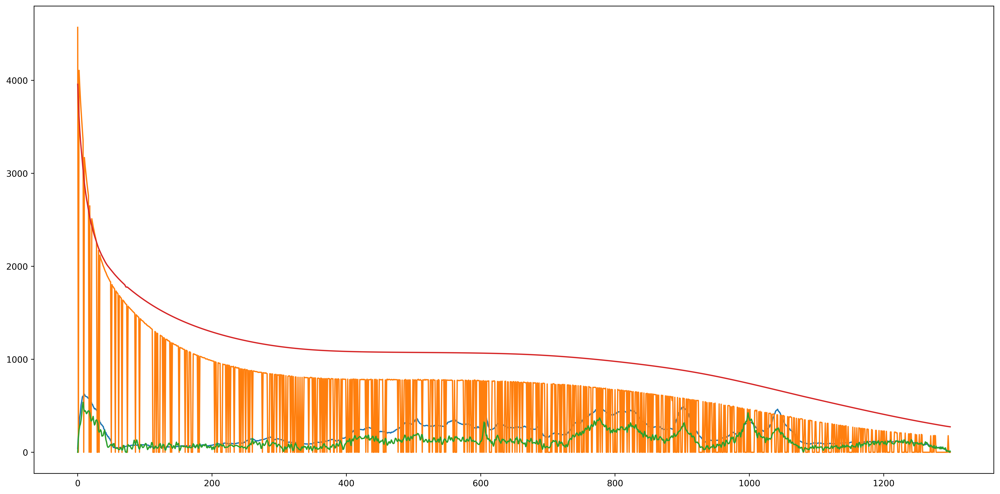

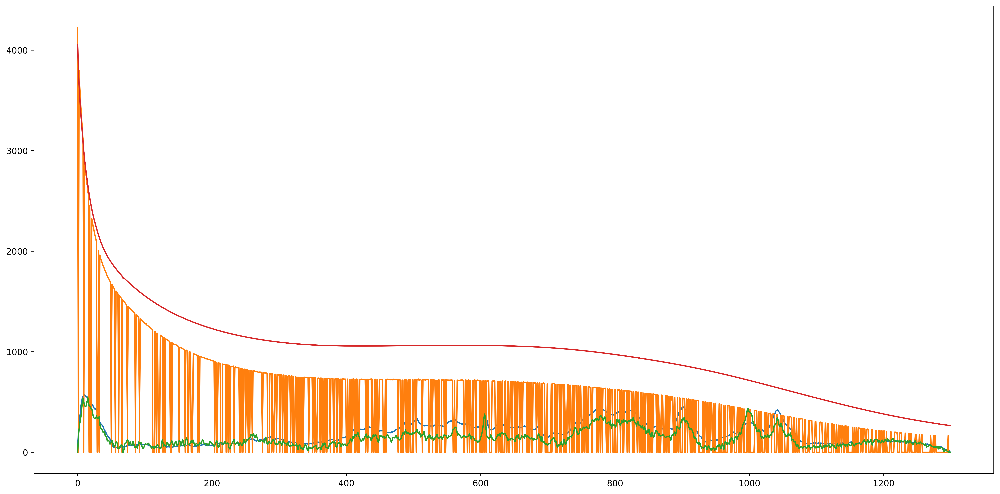

In [ ]:
rvc = SupervisedClassifier(**kwargs)
rvc.fit(data)
